# California Housing Prices

### We will tackle the 'California Housing Prices' dataset and try to predict the prices of homes in California given different attributes.

## The Setup

We will import some commonly used modules and set sensible defaults for graphing and saving figures:

In [1]:
#common imports:
import numpy as np 
import os 
import pandas as pd

#importing matplotlib and seaborn for plotting:
import matplotlib as mpl 
import matplotlib.pyplot as plt 
import seaborn as sns 

#increasing the label size of matplotlib plots for better visibility:
mpl.rc('axes', labelsize=14)
mpl.rc('xtick', labelsize=12)
mpl.rc('ytick', labelsize=12)

## Getting the Data

**About the data**: The original version of the data first appeared in the paper _"Sparse Spatial Autoregressions"_ authored by R. Kelly Pace and Ronald Barry. The data we will be using is a slightly modified version created and used by Aurélien Géron in his excellent book *'Hands-On Machine learning with Scikit-Learn and TensorFlow'*. The data pertains gives information on the median prices of houses in several blocks (an area with a population of about 3,000 - 6,000 people) along with details such as: longitude, latitiude, total_rooms, population etc. It was collected from the 1990 California census.

We will get the data from the github repo where this file is hosted:

In [2]:
#Writing a function to load the data (this makes reausability and automation easier):

def fetch_housing_data():
    
    #The link to where the data is hosted:
    data_url = 'https://raw.githubusercontent.com/Aryagm/California_Housing_Prices/main/data/California_Housing_Prices_Data.csv' 

    #Reading the csv file using pandas (treating it as a pandas dataframe makes it easier and faster to manipulate):
    data = pd.read_csv(data_url)

    #Returning the pandas dataframe:
    return data

In [3]:
#Using our function to fetch the data:
data = fetch_housing_data()

## Taking a look at the Data:

In [4]:
#We can take a look at the top 5 rows of the data using the DataFrame's head() method:
data.head()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,ocean_proximity
0,-122.23,37.88,41.0,880.0,129.0,322.0,126.0,8.3252,452600.0,NEAR BAY
1,-122.22,37.86,21.0,7099.0,1106.0,2401.0,1138.0,8.3014,358500.0,NEAR BAY
2,-122.24,37.85,52.0,1467.0,190.0,496.0,177.0,7.2574,352100.0,NEAR BAY
3,-122.25,37.85,52.0,1274.0,235.0,558.0,219.0,5.6431,341300.0,NEAR BAY
4,-122.25,37.85,52.0,1627.0,280.0,565.0,259.0,3.8462,342200.0,NEAR BAY


Each row represents one block. There are 10 attributes: `longitude`, `latitude`, `housing_median_age`, `total_rooms`, `total_bedrooms`, `population`, `households`, `median_income`, `median_house_value`, and `ocean_proximity`.

In [5]:
#We can use the info() method to get a quick description of the data:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20640 entries, 0 to 20639
Data columns (total 10 columns):
longitude             20640 non-null float64
latitude              20640 non-null float64
housing_median_age    20640 non-null float64
total_rooms           20640 non-null float64
total_bedrooms        20433 non-null float64
population            20640 non-null float64
households            20640 non-null float64
median_income         20640 non-null float64
median_house_value    20640 non-null float64
ocean_proximity       20640 non-null object
dtypes: float64(9), object(1)
memory usage: 1.6+ MB


Notice that the `total_bedrooms` attribute has only 20,433 non-null values (while the others have 20640), meaning that 207 districts are missing this feature. We will need to take care of this later.

All attributes are numerical, except the `ocean_proximity` field. When you looked at the top five rows, you probably noticed that the values in the ocean_proximity column were repetitive, which means that it is probably a categorical attribute. You can find out what categories exist and how many districts belong to each category by using the `value_counts()` method:

In [6]:
data["ocean_proximity"].value_counts()

<1H OCEAN     9136
INLAND        6551
NEAR OCEAN    2658
NEAR BAY      2290
ISLAND           5
Name: ocean_proximity, dtype: int64

Let’s look at the other fields. The `describe()` method shows a summary of the numerical attributes:

In [7]:
data.describe()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value
count,20640.000000,20640.000000,20640.000000,20640.000000,20433.000000,20640.000000,20640.000000,20640.000000,20640.000000
mean,-119.569704,35.631861,28.639486,2635.763081,537.870553,1425.476744,499.539680,3.870671,206855.816909
std,2.003532,2.135952,12.585558,2181.615252,421.385070,1132.462122,382.329753,1.899822,115395.615874
min,-124.350000,32.540000,1.000000,2.000000,1.000000,3.000000,1.000000,0.499900,14999.000000
25%,-121.800000,33.930000,18.000000,1447.750000,296.000000,787.000000,280.000000,2.563400,119600.000000
50%,-118.490000,34.260000,29.000000,2127.000000,435.000000,1166.000000,409.000000,3.534800,179700.000000
75%,-118.010000,37.710000,37.000000,3148.000000,647.000000,1725.000000,605.000000,4.743250,264725.000000
max,-114.310000,41.950000,52.000000,39320.000000,6445.000000,35682.000000,6082.000000,15.000100,500001.000000


The `count`, `mean`, `min`, and `max` rows are self-explanatory. Note that the null values are ignored (so, for example, the count of `total_bedrooms` is 20,433, not 20,640). The `std` row shows the standard deviation, which measures how dispersed the values are. The 25%, 50%, and 75% rows show the corresponding percentiles: a percentile indicates the value below which a given percentage of observations in a group of observations fall. For example, 25% of the districts have a `housing_median_age` lower than 18, while 50% are lower than 29 and 75% are lower than 37. These are often called the 25th percentile (or first quartile), the median, and the 75th percentile (or third quartile).

Another quick way to get a feel of the type of data you are dealing with is to plot a histogram for each numerical attribute. A histogram shows the number of instances(on the vertical axis) that have a given value range (on the horizontal axis). You can either plot this one attribute at a time, or you can call the `hist()` method on the whole dataset (as shown in the following code example), and it will plot a histogram for each numerical attribute.

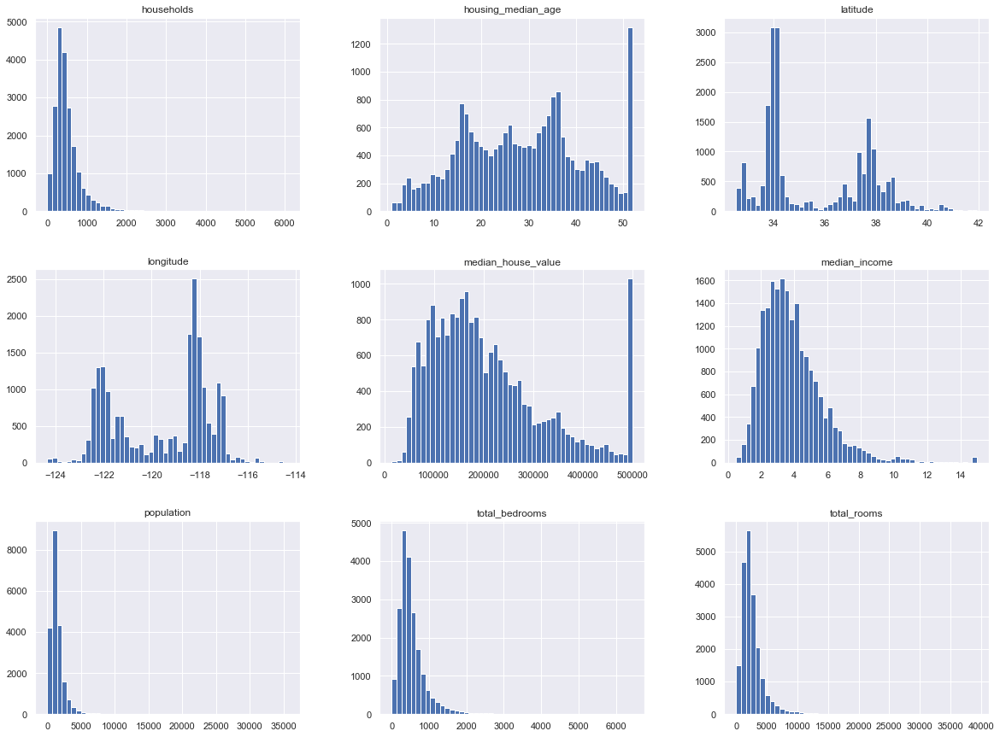

In [8]:
sns.set() #We are using seaborn to make the plots look better. This adds some styling to our plots. You can try removing this and see how the plot looks.
data.hist(bins=50,figsize=(20,15))
plt.show()

What we learnt about the data:

1. If you look at the `median_house_value` plot you might notice that there are quite a lot of houses valued at $500,00. This seems to break the distribution. The fact is that the house prices were capped at 500,00. This means any house valued over 500,000 was counted as being worth 500,000. We need to remove such values later, or our model might learn that the price of houses never increses over 500,000.

2. These attributes have varying scales (the range of values varies a lot arttribute-to-attribute). We need to scale these values so that they fit inside a similiar range (this often improves the accuracy if the models).

3. Many histograms are _tail-heavy_: they extend much farther to the right of the median than to the left. This may make it a bit harder for some Machine Learning algorithms to detect patterns. You can try transforming these attributes later on to have more bell-shaped distributions (try using `np.log()`).

## Discover and Visualize the Data:

We have seen some plots of our data before. We will now look at some other useful visualizations.

Since there is geographical information (latitude and longitude), it is a good idea to create a scatterplot of all districts to visualize the data:

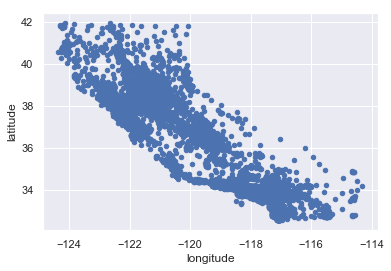

In [9]:
data.plot(kind='scatter',x='longitude',y='latitude') #make sure to put latitude and longitude in the right axes, or else you will get an upside-down mirror image!
plt.show()

This looks like California all right, but other than that it is hard to see any particular pattern. Setting the `alpha` option to 0.1 makes it much easier to visualize the places where there is a high density of data points:

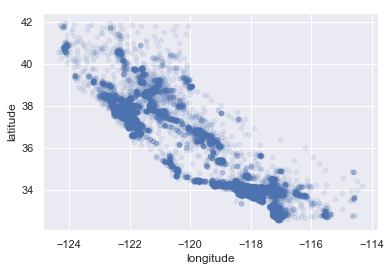

In [10]:
data.plot(kind="scatter", x="longitude", y="latitude", alpha=0.1)
plt.show()

Now that’s much better: you can clearly see the high-density areas, namely the Bay Area and around Los Angeles and San Diego, plus a long line of fairly high density in the Central Valley, in particular around Sacramento and Fresno. 

Now let’s look at the housing prices (Figure 2-13). The radius of each circle represents the district’s population (option `s`), and the color represents the price (option `c`). We will use a predefined color map (option `cmap`) called jet, which ranges from blue (low values) to red (high prices):

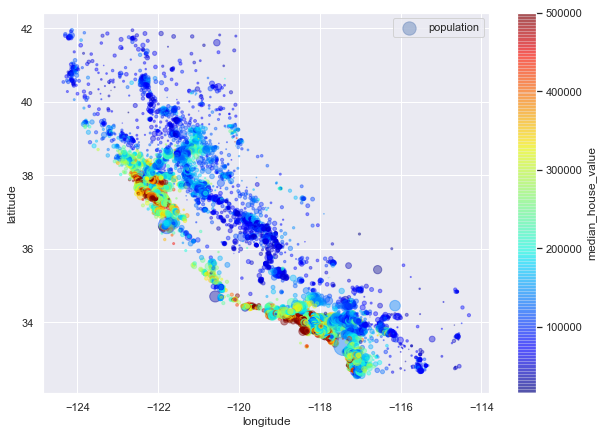

In [11]:
data.plot(kind="scatter", x="longitude", y="latitude", alpha=0.4,
             s=data["population"]/100, label="population", figsize=(10,7),
             c="median_house_value", cmap=plt.get_cmap("jet"), colorbar=True)
plt.legend()
plt.show()

This image tells you that the housing prices are very much related to the location (e.g., close to the ocean) and to the population density, as you probably knew already.

To make the image look prettier we can underlay an image of california under the plot:

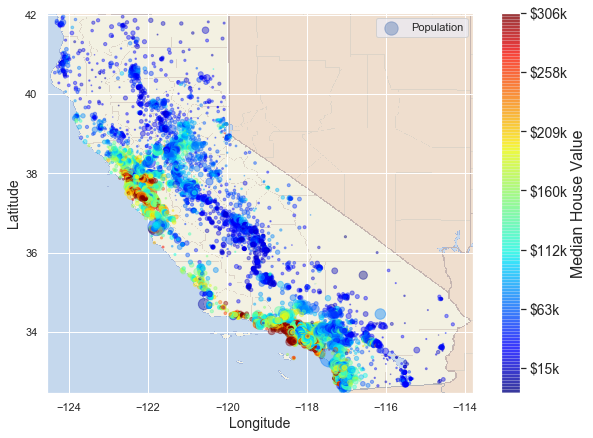

In [12]:
import matplotlib.image as mpimg

image = 'https://raw.githubusercontent.com/Aryagm/California_Housing_Prices/main/data/California_Image.png'

california_img=mpimg.imread(image)

ax = data.plot(kind="scatter", x="longitude", y="latitude", figsize=(10,7),
                  s=data['population']/100, label="Population",
                  c="median_house_value", cmap=plt.get_cmap("jet"),
                  colorbar=False, alpha=0.4)

plt.imshow(california_img, extent=[-124.55, -113.80, 32.45, 42.05], alpha=0.5,
           cmap=plt.get_cmap("jet"))

plt.ylabel("Latitude", fontsize=14)
plt.xlabel("Longitude", fontsize=14)

prices = data["median_house_value"]
tick_values = np.linspace(prices.min(), prices.max(), 11)

cbar = plt.colorbar(ticks=tick_values/prices.max())
cbar.ax.set_yticklabels(["$%dk"%(round(v/1000)) for v in tick_values], fontsize=14)
cbar.set_label('Median House Value', fontsize=16)

plt.show()

### Correlations:

Now lets look at how the attributes are related to each other. Since the dataset is not too large, you can easily compute the standard correlation coefficient (also called *_Pearson’s r_*) between every pair of attributes using the `corr()` method:

In [13]:
corr_matrix = data.corr()

Now let’s look at how much each attribute correlates with the median house value:

In [14]:
 corr_matrix["median_house_value"].sort_values(ascending=False)

median_house_value    1.000000
median_income         0.688075
total_rooms           0.134153
housing_median_age    0.105623
households            0.065843
total_bedrooms        0.049686
population           -0.024650
longitude            -0.045967
latitude             -0.144160
Name: median_house_value, dtype: float64

We can also visualise the matrix to form a heatmap of the correlations:

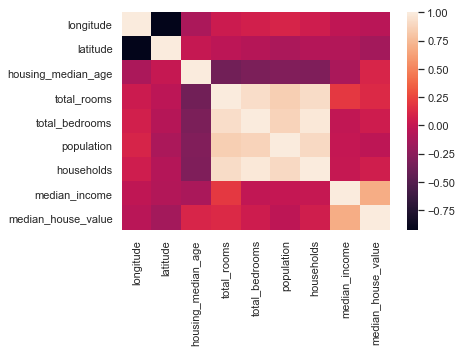

In [15]:
sns.heatmap(corr_matrix)

The correlation coefficient ranges from –1 to 1. When it is close to 1, it means that there is a strong positive correlation; for example, the median house value tends to go up when the median income goes up. When the coefficient is close to –1, it means that there is a strong negative correlation; you can see a small negative correlation between the latitude and the median house value (i.e., prices have a slight tendency to go down when you go north). Finally, coefficients close to 0 mean that there is no linear correlation. 

Another way to check for correlation between attributes is to use the pandas scatter_matrix() function, which plots every numerical attribute against every numerical attribute. Since there are now 11 numerical attributes, you would get 11^2 = 121 plots, which would not fit on a page—so let’s just focus on a few promising attributes that seem most correlated with the median housing value:

In [16]:
from pandas.plotting import scatter_matrix
#Choosing features which are the most correlated with median_house_value:
attributes = ["median_house_value", "median_income", "total_rooms","housing_median_age"]
#scatter_matrix(data[attributes], figsize=(12, 8))

The main diagonal (top left to bottom right) would be full of straight lines if pandas plotted each variable against itself, which would not be very useful. So instead pandas displays a histogram of each attribute.

The most promising attribute to predict the median house value is the median income, so let’s zoom in on their correlation scatterplot:

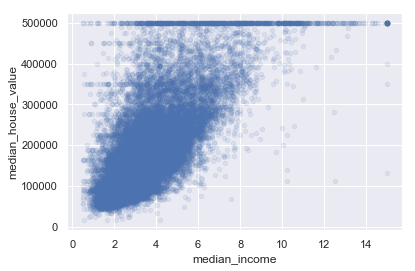

In [17]:
data.plot(kind="scatter", x="median_income", y="median_house_value",alpha=0.1)

This plot reveals a few things. First, the correlation is indeed very strong; you can clearly see the upward trend, and the points are not too dispersed. Second, the price cap that we noticed earlier is clearly visible as a horizontal line at $500,000. We will do something about this:

We will remove all houses whose `median_house_value` is more than 490,000. This will remove about 1,100-1,200 instances from our dataset which is about 5% of the total dataset. Though removing data might seem like a bad idea, bad data can hinder your models performance and cause it to work worse:

In [18]:
data = data.loc[data['median_house_value'] < 490000.0]

Lets take at our data now:

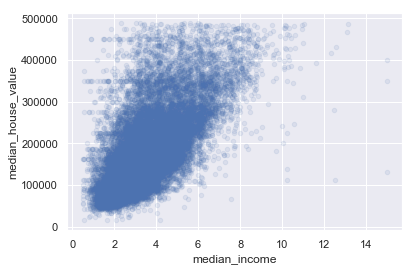

In [19]:
data.plot(kind="scatter", x="median_income", y="median_house_value",alpha=0.1)

Our data looks much better now!

### Trying Attribute Combinations:

One last thing you may want to do before preparing the data for Machine Learning algorithms is to try out various attribute combinations. For example, the total number of rooms in a district is not very useful if you don’t know how many households there are. What you really want is the number of rooms per household. Similarly, the total number of bedrooms by itself is not very useful: you probably want to compare it to the number of rooms. And the population per household also seems like an interesting attribute combination to look at. Let’s create these new attributes (on a copy of the original dataset).

In [20]:
data_copy = data.copy()

In [21]:
data_copy["rooms_per_household"] = data_copy["total_rooms"]/data_copy["households"]
data_copy["bedrooms_per_room"] = data_copy["total_bedrooms"]/data_copy["total_rooms"]
data_copy["population_per_household"]=data_copy["population"]/data_copy["households"]

In [22]:
corr_matrix = data_copy.corr()
corr_matrix["median_house_value"].sort_values(ascending=False)

median_house_value          1.000000
median_income               0.645032
total_rooms                 0.145735
rooms_per_household         0.109828
households                  0.097021
total_bedrooms              0.076465
housing_median_age          0.063295
population                  0.015378
population_per_household   -0.021035
longitude                  -0.046240
latitude                   -0.149483
bedrooms_per_room          -0.217881
Name: median_house_value, dtype: float64

The new bedrooms_per_room attribute is much more correlated with the median house value than the total number of rooms or bedrooms. Apparently houses with a lower bedroom/room ratio tend to be more expensive. The number of rooms per household is also more informative than the total number of rooms in a district—obviously the larger the houses, the more expensive they are.

In [23]:
#Lets have a look at our data_copy now:
data_copy.describe()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,rooms_per_household,bedrooms_per_room,population_per_household
count,19608.000000,19608.000000,19608.000000,19608.000000,19408.000000,19608.000000,19608.000000,19608.000000,19608.000000,19608.000000,19408.000000,19608.000000
mean,-119.562377,35.652822,28.362811,2619.730722,539.696208,1441.960424,501.225877,3.670824,191438.341289,5.359569,0.215016,3.097853
std,2.005685,2.150565,12.502426,2182.204210,422.444572,1144.311362,383.221366,1.564842,96243.163028,2.294186,0.056926,10.649982
min,-124.350000,32.540000,1.000000,2.000000,2.000000,3.000000,2.000000,0.499900,14999.000000,0.846154,0.100000,0.692308
25%,-121.760000,33.930000,18.000000,1438.000000,297.000000,797.000000,282.000000,2.524875,116300.000000,4.414798,0.177728,2.447445
50%,-118.510000,34.270000,28.000000,2110.000000,437.000000,1181.000000,411.000000,3.444950,173400.000000,5.183874,0.204614,2.838720
75%,-117.990000,37.730000,37.000000,3122.000000,648.000000,1748.250000,606.000000,4.576025,247300.000000,5.967599,0.240913,3.306995
max,-114.310000,41.950000,52.000000,39320.000000,6445.000000,35682.000000,6082.000000,15.000100,489800.000000,132.533333,1.000000,1243.333333


But we wont be using this data yet. We will be using functions and Transformers to do these transformations. But before that we need a training and test set.

## Creating a Test Set

In [24]:
from sklearn.model_selection import train_test_split

train_set, test_set = train_test_split(data, test_size=0.2, random_state=42)

In [25]:
test_set.head()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,ocean_proximity
17718,-121.77,37.33,8.0,3088.0,474.0,1799.0,456.0,7.2707,355300.0,<1H OCEAN
12470,-121.46,38.58,52.0,4408.0,807.0,1604.0,777.0,3.8914,181600.0,INLAND
7427,-118.20,33.95,41.0,679.0,184.0,788.0,185.0,2.1406,165300.0,<1H OCEAN
4012,-118.60,34.16,37.0,3441.0,584.0,1283.0,544.0,4.1656,313100.0,<1H OCEAN
7990,-118.18,33.86,39.0,2925.0,732.0,1702.0,642.0,2.3750,160800.0,<1H OCEAN


So far we have considered purely random sampling methods. This is generally fine if your dataset is large enough (especially relative to the number of attributes), but if it is not, you run the risk of introducing a significant sampling bias. When a survey company decides to call 1,000 people to ask them a few questions, they don’t just pick
1,000 people randomly in a phone book. They try to ensure that these 1,000 people are representative of the whole population. For example, the US population is 51.3% females and 48.7% males, so a well-conducted survey in the US would try to maintain this ratio in the sample: 513 female and 487 male. This is called stratified sampling:
the population is divided into homogeneous subgroups called strata, and the right number of instances are sampled from each stratum to guarantee that the test set is representative of the overall population.

Suppose you chatted with experts who told you that the median income is a very important attribute to predict median housing prices. You may want to ensure that the test set is representative of the various categories of incomes in the whole dataset. Since the median income is a continuous numerical attribute, you first need to create an income category attribute. Let’s look at the median income histogram more closely: 

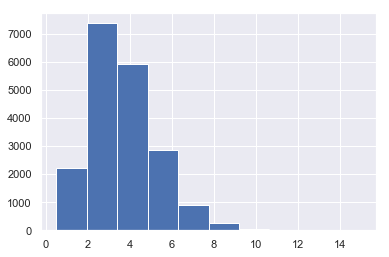

In [26]:
data["median_income"].hist()

Most median income values are clustered around 1.5 to 6 (i.e.,$15,000–$60,000), but some median incomes go far beyond 6. It is important to have a sufficient number of instances in your dataset for each stratum, or else the estimate of a stratum’s importance may be biased. This means that you should not have too many strata, and each stratum should be large enough. The following code uses the `pd.cut()` function to create an income category attribute with five categories (labeled from 1 to 5): category 1 ranges from 0 to 1.5 (i.e., less than $15,000), category 2 from 1.5 to 3, and so on:

In [27]:
data["income_cat"] = pd.cut(data["median_income"],
                               bins=[0., 1.5, 3.0, 4.5, 6., np.inf],
                               labels=[1, 2, 3, 4, 5])

<ipython-input-27-23e14abf29f6>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data["income_cat"] = pd.cut(data["median_income"],


In [28]:
data["income_cat"].value_counts()

3    7083
2    6546
4    3487
5    1679
1     813
Name: income_cat, dtype: int64

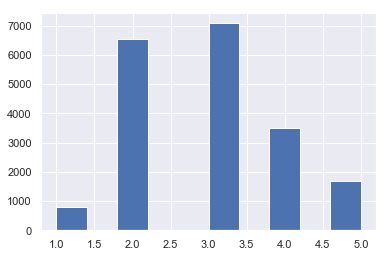

In [29]:
#These income categories are represented in this graph:
data["income_cat"].hist()

Now you are ready to do stratified sampling based on the income category. For this you can use Scikit-Learn’s `StratifiedShuffleSplit` class:

In [30]:
sample_incomplete_rows = data[data.isnull().any(axis=1)]
sample_incomplete_rows

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,ocean_proximity,income_cat
290,-122.16,37.77,47.0,1256.0,NaN,570.0,218.0,4.3750,161900.0,NEAR BAY,3
341,-122.17,37.75,38.0,992.0,NaN,732.0,259.0,1.6196,85100.0,NEAR BAY,2
538,-122.28,37.78,29.0,5154.0,NaN,3741.0,1273.0,2.5762,173400.0,NEAR BAY,2
563,-122.24,37.75,45.0,891.0,NaN,384.0,146.0,4.9489,247100.0,NEAR BAY,4
696,-122.10,37.69,41.0,746.0,NaN,387.0,161.0,3.9063,178400.0,NEAR BAY,3
...,...,...,...,...,...,...,...,...,...,...,...
20267,-119.19,34.20,18.0,3620.0,NaN,3171.0,779.0,3.3409,220500.0,NEAR OCEAN,3
20268,-119.18,34.19,19.0,2393.0,NaN,1938.0,762.0,1.6953,167400.0,NEAR OCEAN,2
20372,-118.88,34.17,15.0,4260.0,NaN,1701.0,669.0,5.1033,410700.0,<1H OCEAN,4
20460,-118.75,34.29,17.0,5512.0,NaN,2734.0,814.0,6.6073,258100.0,<1H OCEAN,5


In [31]:
from sklearn.model_selection import StratifiedShuffleSplit
train_index_lst = []
test_index_lst = []
split = StratifiedShuffleSplit(n_splits=1, test_size=0.2)
for train_index, test_index in split.split(data, data["income_cat"]):
    train_index_lst.append(train_index)
    test_index_lst.append(test_index)

strat_train_set = data.iloc[train_index_lst[0],:]
strat_test_set = data.iloc[test_index_lst[0],:]

In [32]:
sample_incomplete_rows = strat_train_set[strat_train_set.isnull().any(axis=1)]
sample_incomplete_rows

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,ocean_proximity,income_cat
12414,-116.21,33.75,22.0,894.0,NaN,830.0,202.0,3.0673,68200.0,INLAND,3
16879,-122.39,37.60,34.0,707.0,NaN,381.0,156.0,4.3750,340900.0,NEAR OCEAN,3
4591,-118.28,34.06,42.0,2472.0,NaN,3795.0,1179.0,1.2254,162500.0,<1H OCEAN,1
3354,-120.67,40.50,15.0,5343.0,NaN,2503.0,902.0,3.5962,85900.0,INLAND,3
5665,-118.29,33.73,30.0,3161.0,NaN,1865.0,771.0,2.7139,231700.0,NEAR OCEAN,2
...,...,...,...,...,...,...,...,...,...,...,...
3482,-118.45,34.30,27.0,2676.0,NaN,2661.0,623.0,4.3047,152100.0,<1H OCEAN,3
11096,-117.87,33.83,27.0,2287.0,NaN,1140.0,351.0,5.6163,231000.0,<1H OCEAN,4
4309,-118.32,34.09,44.0,2666.0,NaN,2297.0,726.0,1.6760,208800.0,<1H OCEAN,2
3958,-118.59,34.20,21.0,1789.0,NaN,2300.0,677.0,2.7540,179800.0,<1H OCEAN,2


Let’s see if this worked as expected. You can start by looking at the income category proportions in the test set:

In [33]:
strat_test_set["income_cat"].value_counts() / len(strat_test_set)

3    0.361295
2    0.333758
4    0.177715
5    0.085671
1    0.041560
Name: income_cat, dtype: float64

With similar code you can measure the income category proportions in the full dataset:

In [34]:
data["income_cat"].value_counts() / len(data)

3    0.361230
2    0.333843
4    0.177836
5    0.085628
1    0.041463
Name: income_cat, dtype: float64

The below table compares the income category proportions in the overall dataset, in the test set generated with stratified sampling, and in a test set generated using purely random sampling. As you can see, the test set generated using stratified sampling has income category proportions almost identical to those in the full dataset, whereas the test set generated using purely random sampling is skewed

In [35]:
def income_cat_proportions(housing):
    return housing["income_cat"].value_counts() / len(housing)

train_set, test_set = train_test_split(data, test_size=0.2)

compare_props = pd.DataFrame({
    "Overall": income_cat_proportions(data),
    "Stratified": income_cat_proportions(strat_test_set),
    "Random": income_cat_proportions(test_set),
}).sort_index()
compare_props["Rand. %error"] = 100 * compare_props["Random"] / compare_props["Overall"] - 100
compare_props["Strat. %error"] = 100 * compare_props["Stratified"] / compare_props["Overall"] - 100

In [36]:
compare_props

,Overall,Stratified,Random,Rand. %error,Strat. %error
1,0.041463,0.041560,0.040031,-3.453882,0.235778
2,0.333843,0.333758,0.325599,-2.469465,-0.025474
3,0.361230,0.361295,0.367415,1.712059,0.018035
4,0.177836,0.177715,0.179755,1.079452,-0.067549
5,0.085628,0.085671,0.087200,1.835950,0.049354


Now you should remove the income_cat attribute so the data is back to its original state:

In [37]:
for set_ in (strat_train_set, strat_test_set):
    set_.drop("income_cat", axis=1, inplace=True)

C:\Users\Workstation\AppData\Roaming\Python\Python38\site-packages\pandas\core\frame.py:4110: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return super().drop(


## Prepare the data for Machine Learning algorithms

It’s time to prepare the data for your Machine Learning algorithms. Instead of doing this manually, you should write functions for this purpose (this improves reproducibility and scalability).

But first let’s revert to a clean training set (by copying strat_train_set once again). Let’s also separate the predictors and the labels, since we don’t necessarily want to apply the same transformations to the predictors and the target values (note that drop() creates a copy of the data and does not affect strat_train_set):

In [38]:
data = strat_train_set.drop("median_house_value", axis=1) # drop labels for training set
data_labels = strat_train_set["median_house_value"].copy()

Most Machine Learning algorithms cannot work with missing features, so let’s create a few functions to take care of them. We saw earlier that the total_bedrooms attribute has some missing values, so let’s take a look at the missing data and fix it.

In [39]:
sample_incomplete_rows = data[data.isnull().any(axis=1)].head()
sample_incomplete_rows

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,ocean_proximity
12414,-116.21,33.75,22.0,894.0,NaN,830.0,202.0,3.0673,INLAND
16879,-122.39,37.60,34.0,707.0,NaN,381.0,156.0,4.3750,NEAR OCEAN
4591,-118.28,34.06,42.0,2472.0,NaN,3795.0,1179.0,1.2254,<1H OCEAN
3354,-120.67,40.50,15.0,5343.0,NaN,2503.0,902.0,3.5962,INLAND
5665,-118.29,33.73,30.0,3161.0,NaN,1865.0,771.0,2.7139,NEAR OCEAN


Scikit-Learn provides a handy class to take care of missing values: SimpleImputer. Here is how to use it. First, you need to create a SimpleImputer instance, specifying that you want to replace each attribute’s missing values with the median of that attribute:

In [40]:
from sklearn.impute import SimpleImputer
imputer = SimpleImputer(strategy="median")

Since the median can only be computed on numerical attributes, you need to create a copy of the data without the text attribute ocean_proximity:

In [41]:
data_num = data.drop("ocean_proximity", axis=1)
# alternatively: data_num = data.select_dtypes(include=[np.number])

Now you can fit the imputer instance to the training data using the `fit()` method:

In [42]:
imputer.fit(data_num)

SimpleImputer(strategy='median')

The imputer has simply computed the median of each attribute and stored the result in its statistics_ instance variable. Only the total_bedrooms attribute had missing values, but we cannot be sure that there won’t be any missing values in new data after the system goes live, so it is safer to apply the imputer to all the numerical attributes

In [43]:
print(imputer.statistics_)
print(data_num.median().values)

[-118.495    34.27     28.     2112.      436.     1183.      411.
    3.4431]
[-118.495    34.27     28.     2112.      436.     1183.      411.
    3.4431]


Now you can use this “trained” imputer to transform the training set by replacing missing values with the learned medians:

In [44]:
X = imputer.transform(data_num)

The result is a plain NumPy array containing the transformed features. If you want to put it back into a pandas DataFrame, it’s simple:

In [47]:
data_tr = pd.DataFrame(X, columns=data_num.columns,
                          index=data_num.index)

In [49]:
data_tr.head()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income
11589,-118.03,33.78,26.0,2001.0,302.0,836.0,298.0,5.1061
4446,-118.21,34.07,31.0,1077.0,300.0,1198.0,274.0,2.1333
14030,-117.15,32.75,27.0,3166.0,867.0,1332.0,817.0,2.6742
12755,-121.38,38.61,27.0,2375.0,537.0,863.0,452.0,3.0086
13946,-117.22,34.26,16.0,8020.0,1432.0,1749.0,540.0,4.9716


## Handling Text and Categorical Attributes

So far we have only dealt with numerical attributes, but now let’s look at text attributes. In this dataset, there is just one: the `ocean_proximity` attribute. Let’s look at its value for the first 10 instances:

In [51]:
data_cat = data[["ocean_proximity"]]
data_cat.head(10)

,ocean_proximity
11589,<1H OCEAN
4446,<1H OCEAN
14030,NEAR OCEAN
12755,INLAND
13946,INLAND
18942,INLAND
16062,NEAR BAY
11606,<1H OCEAN
19197,<1H OCEAN
16090,NEAR OCEAN


It’s not arbitrary text: there are a limited number of possible values, each of which represents a category. So this attribute is a categorical attribute. Most Machine Learning algorithms prefer to work with numbers, so let’s convert these categories from text to numbers. For this, we can use Scikit-Learn’s OrdinalEncoder class:

In [52]:
from sklearn.preprocessing import OrdinalEncoder

ordinal_encoder = OrdinalEncoder()
data_cat_encoded = ordinal_encoder.fit_transform(data_cat)
data_cat_encoded[:10]

array([[0.],
       [0.],
       [4.],
       [1.],
       [1.],
       [1.],
       [3.],
       [0.],
       [0.],
       [4.]])

You can get the list of categories using the categories_ instance variable. It is a list containing a 1D array of categories for each categorical attribute (in this case, a list containing a single array since there is just one categorical attribute):

In [53]:
ordinal_encoder.categories_

[array(['<1H OCEAN', 'INLAND', 'ISLAND', 'NEAR BAY', 'NEAR OCEAN'],
       dtype=object)]

One issue with this representation is that ML algorithms will assume that two nearby values are more similar than two distant values. This may be fine in some cases (e.g., for ordered categories such as “bad,” “average,” “good,” and “excellent”), but it is obviously not the case for the ocean_proximity column (for example, categories 0 and 4 are clearly more similar than categories 0 and 1). To fix this issue, a common solution is to create one binary attribute per category: one attribute equal to 1 when the category is “<1H OCEAN” (and 0 otherwise), another attribute equal to 1 when the category is “INLAND” (and 0 otherwise), and so on. This is called one-hot encoding, because only one attribute will be equal to 1 (hot), while the others will be 0 (cold). The new attributes are sometimes called dummy attributes. Scikit-Learn provides a `OneHotEncoder` class to convert categorical values into one-hot vectors:

In [54]:
from sklearn.preprocessing import OneHotEncoder

cat_encoder = OneHotEncoder()
data_cat_1hot = cat_encoder.fit_transform(data_cat)
data_cat_1hot

<15686x5 sparse matrix of type '<class 'numpy.float64'>'
	with 15686 stored elements in Compressed Sparse Row format>

Once again, you can get the list of categories using the encoder’s `categories_instance` variable:

In [55]:
cat_encoder.categories_

[array(['<1H OCEAN', 'INLAND', 'ISLAND', 'NEAR BAY', 'NEAR OCEAN'],
       dtype=object)]

## Custom Transformers

Although Scikit-Learn provides many useful transformers, you will need to write your own for tasks such as custom cleanup operations or combining specific attributes. You will want your transformer to work seamlessly with Scikit-Learn functionalities (such as pipelines), and since Scikit-Learn relies on duck typing (not inheritance), all you need to do is create a class and implement three methods: fit()(returning self), transform(), and fit_transform().
You can get the last one for free by simply adding TransformerMixin as a base class.If you add BaseEstimator as a base class (and avoid *args and **kargs in your constructor), you will also get two extra methods (get_params() and set_params()) that will be useful for automatic hyperparameter tuning.

For example, here is a small transformer class that adds the combined attributes we discussed earlier:

In [56]:
from sklearn.base import BaseEstimator, TransformerMixin

#The variaboles are column indexes
rooms_ix, bedrooms_ix, population_ix, households_ix = 3, 4, 5, 6 

#Class is like a different environment. We can define functions, variables within the class.
#Self enables us to use methods and attributes in the class

class CombinedAttributesAdder(BaseEstimator, TransformerMixin): #Attributes we can use inside the class (BaseEstimator and TransformerMixin)
    def __init__(self, add_bedrooms_per_room=True): # no *args or **kargs; #add_bedrooms_per_room - if we want to add the column to the dataset
        self.add_bedrooms_per_room = add_bedrooms_per_room #Assign global (canbe used outside the class) variable to add_bedrooms_per_room
    def fit(self, X, y=None): #fit 
        return self  # nothing else to do

        #X IS THE DATASET
    
    def transform(self, X): #Creates the different attributes
        rooms_per_household = X[:, rooms_ix] / X[:, households_ix] #The variables after the comma give the column index
        population_per_household = X[:, population_ix] / X[:, households_ix]
        if self.add_bedrooms_per_room:  #If add_bedrooms_per_room is true do this:
            bedrooms_per_room = X[:, bedrooms_ix] / X[:, rooms_ix] #adding the bedrooms_per_room to the dataset
            return np.c_[X, rooms_per_household, population_per_household, #return a reshaped numpy array with the new dataset and newly created columns
                         bedrooms_per_room]
        else:
            return np.c_[X, rooms_per_household, population_per_household] #Return the dataset  and new columns without adding bedrooms_per_room to the dataset

attr_adder = CombinedAttributesAdder(add_bedrooms_per_room=False) #Instantiniate the class with the hyperparameters and a new name
data_extra_attribs = attr_adder.transform(data.values)# Use the class on housing.columns



`Housing_extra_attribs` is a NumPy array, we've lost the column names (unfortunately, that's a problem with Scikit-Learn). To recover a `DataFrame`, you could run this:

In [57]:
data_extra_attribs = pd.DataFrame(
    data_extra_attribs,
    columns=list(data.columns)+["rooms_per_household", "population_per_household"],
    index=data.index)
data_extra_attribs.head()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,ocean_proximity,rooms_per_household,population_per_household
11589,-118.03,33.78,26,2001,302,836,298,5.1061,<1H OCEAN,6.71477,2.80537
4446,-118.21,34.07,31,1077,300,1198,274,2.1333,<1H OCEAN,3.93066,4.37226
14030,-117.15,32.75,27,3166,867,1332,817,2.6742,NEAR OCEAN,3.87515,1.63035
12755,-121.38,38.61,27,2375,537,863,452,3.0086,INLAND,5.25442,1.90929
13946,-117.22,34.26,16,8020,1432,1749,540,4.9716,INLAND,14.8519,3.23889


## Feature Scaling

One of the most important transformations you need to apply to your data is feature
scaling. With few exceptions, Machine Learning algorithms don’t perform well when
the input numerical attributes have very different scales. This is the case for the hous‐
ing data: the total number of rooms ranges from about 6 to 39,320, while the median
incomes only range from 0 to 15. Note that scaling the target values is generally not
required. Scikit-Learn provides a transformer called `StandardScaler` for standardization.

## Transformation Pipelines

As you can see, there are many data transformation steps that need to be executed in the right order. Fortunately, Scikit-Learn provides the Pipeline class to help with such sequences of transformations. Here is a small pipeline for the numerical attributes:

In [59]:
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler

num_pipeline = Pipeline([
        ('imputer', SimpleImputer(strategy="median")), #Removing null values by imputing the median.
        ('attribs_adder', CombinedAttributesAdder()), #The transformer we wrte to add features
        ('std_scaler', StandardScaler()), #Feature Scaling we discussed Earlier.
    ])

data_num_tr = num_pipeline.fit_transform(data_num)

So far, we have handled the categorical columns and the numerical columns sepa‐
rately. It would be more convenient to have a single transformer able to handle all col‐
umns, applying the appropriate transformations to each column. In version 0.20,
Scikit-Learn introduced the ColumnTransformer for this purpose, and the good news
is that it works great with pandas DataFrames. Let’s use it to apply all the transformations to the housing data:

In [123]:
from sklearn.compose import ColumnTransformer

#Defining numeric and categorical attributes
num_attribs = list(data_num)
cat_attribs = ["ocean_proximity"]

full_pipeline = ColumnTransformer([
 ("num", num_pipeline, num_attribs), #Define what to do with the numeric attributes. In this case run it through the previous pipeline
 ("cat", OneHotEncoder(), cat_attribs), #Define what to with categorical attributes. In this case we will One-Hot_Encode them.
 ])
data_prepared = full_pipeline.fit_transform(data) #Put our data through the pipeline.

In [124]:
data_prepared.shape

(15686, 16)

## Select and Train a Model (The hard way)

At last! We framed the problem, you got the data and explored it, you sampled a
training set and a test set, and you wrote transformation pipelines to clean up and
prepare your data for Machine Learning algorithms automatically. You are now ready
to select and train a Machine Learning model

### Training and Evaluating on the Training Set:

The good news is that thanks to all these previous steps, things are now going to be much simpler than you might think. Let’s first train a Linear Regression model:

In [66]:
from sklearn.linear_model import LinearRegression

lin_reg = LinearRegression()
lin_reg.fit(data_prepared, data_labels)

LinearRegression()

Done! You now have a working Linear Regression model.  Let’s measure this regression model’s RMSE on the whole training set using Scikit-Learn’s `mean_squared_error()` function:

In [73]:
from sklearn.metrics import mean_absolute_error
data_predictions = lin_reg.predict(data_prepared)
lin_mae = mean_squared_error(data_labels, data_predictions, squared=False) #If you dont specify squared = False, you will get the MSE instead of the RMSE
lin_mae

58973.78784122167

This is better than nothing, but clearly not a great score: most districts’ median_hous
ing_values range between \$120,000 and \$265,000, so a typical prediction error of
\$58,973 is not very satisfying. This is an example of a model underfitting the training
data.

Let’s train a DecisionTreeRegressor:

In [72]:
from sklearn.tree import DecisionTreeRegressor

tree_reg = DecisionTreeRegressor(random_state=42)
tree_reg.fit(data_prepared, data_labels)

DecisionTreeRegressor(random_state=42)

In [75]:
from sklearn.metrics import mean_absolute_error

data_predictions = tree_reg.predict(data_prepared)
tree_mae = mean_squared_error(data_labels, data_predictions, squared=False) #If you dont specify squared = False, you will get the MSE instead of the RMSE
tree_mae

0.0

Wait, what!? No error at all? Could this model really be absolutely perfect? Of course, it is much more likely that the model has badly overfit the data.

## Better Evaluation Using Cross-Validation

A great alternative is to use Scikit-Learn’s K-fold cross-validation feature. The follow‐
ing code randomly splits the training set into 10 distinct subsets called folds, then it
trains and evaluates the Decision Tree model 10 times, picking a different fold for
evaluation every time and training on the other 9 folds. The result is an array con‐
taining the 10 evaluation scores:


In [76]:
from sklearn.model_selection import cross_val_score

scores = cross_val_score(tree_reg, data_prepared, data_labels,
                         scoring="neg_mean_squared_error", cv=10) #Scikit-Learn’s cross-validation features expect a utility function (greater is better) rather than a cost function (lower is better), so the scoring function is actually the opposite of the MSE (i.e., a negative value), which is why the preceding code computes scores before calculating the square root
tree_rmse_scores = np.sqrt(-scores)

In [77]:
def display_scores(scores):
    print("Scores:", scores)
    print("Mean:", scores.mean())
    print("Standard deviation:", scores.std())

display_scores(tree_rmse_scores)

Scores: [66835.1924582  62764.71462972 62915.16185167 64222.65985025
 65746.38810912 62441.96898018 62934.00059684 64713.50801232
 60985.09552568 62615.02135458]
Mean: 63617.37113685558
Standard deviation: 1657.0227609799667


Now the Decision Tree doesn’t look as good as it did earlier. In fact, it seems to perform worse than the Linear Regression model! The Decision Tree has a
score of approximately 71,407, generally ±2,439. 

Let’s compute the same scores for the Linear Regression model just to be sure:

In [78]:
lin_scores = cross_val_score(lin_reg, data_prepared, data_labels,
                             scoring="neg_mean_squared_error", cv=10)
lin_rmse_scores = np.sqrt(-lin_scores)
display_scores(lin_rmse_scores)

Scores: [61338.14096146 61544.03974661 59943.729625   59370.17690255
 57364.34919136 58520.81961124 62686.3340819  58835.43605811
 57007.54571487 57212.29036427]
Mean: 59382.28622573659
Standard deviation: 1875.957297901684


That’s right: the Decision Tree model is overfitting so badly that it performs worse
than the Linear Regression model. 

Let’s try one last model now: the `RandomForestRegressor`.

In [80]:
from sklearn.ensemble import RandomForestRegressor

forest_reg = RandomForestRegressor(n_estimators=100, random_state=42)
forest_reg.fit(data_prepared, data_labels)

RandomForestRegressor(random_state=42)

In [85]:
forest_scores = cross_val_score(forest_reg, data_prepared, data_labels,
                             scoring="neg_mean_squared_error", cv=10,verbose=2, n_jobs=-1)
forest_rmse_scores = np.sqrt(-forest_scores)
display_scores(forest_rmse_scores)

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
Scores: [47523.91667252 45826.10000733 42031.36408043 45268.32064021
 44656.68316566 44249.98735599 44695.58296749 44087.54593594
 42747.41213717 43453.1105392 ]
Mean: 44454.002350195
Standard deviation: 1484.2137343477411
[Parallel(n_jobs=-1)]: Done  10 out of  10 | elapsed:  2.1min finished


Wow, this is much better: Random Forests look very promising.

## Fine-Tune Your Model

Let’s assume that you now have a shortlist of promising models. You now need to fine-tune them. Let’s look at a few ways you can do that.

Instead of tweaking hyperparameters manually, you should get Scikit-Learn’s GridSearchCV to search for you. All you need
to do is tell it which hyperparameters you want it to experiment with and what values
to try out, and it will use cross-validation to evaluate all the possible combinations of
hyperparameter values. For example, the following code searches for the best combi‐
nation of hyperparameter values for the RandomForestRegressor:

In [86]:
from sklearn.model_selection import GridSearchCV

#The list of parameters whose combinations we want to try out
param_grid = [
    {'n_estimators':[3, 10, 30], 'max_features':[2,4,6,8]}, #GridSearch will first try combinations in the first dict and then of the second dict(on the next line)
    {'bootstrap':[False],'n_estimators':[3,10],'max_features':[2,3,4]},
  ]

forest_reg = RandomForestRegressor()#Instantiate the regressor

grid_search = GridSearchCV(forest_reg,param_grid,cv=5,scoring = 'neg_mean_squared_error', return_train_score = True, n_jobs=-1) #Set parameters for the grid search.

grid_search.fit(data_prepared, data_labels)#Fit the grid search to the data

GridSearchCV(cv=5, estimator=RandomForestRegressor(), n_jobs=-1,
             param_grid=[{'max_features': [2, 4, 6, 8],
                          'n_estimators': [3, 10, 30]},
                         {'bootstrap': [False], 'max_features': [2, 3, 4],
                          'n_estimators': [3, 10]}],
             return_train_score=True, scoring='neg_mean_squared_error')

In [87]:
grid_search.best_params_

{'max_features': 8, 'n_estimators': 30}

You can also get the best estimator directly:

In [88]:
grid_search.best_estimator_

RandomForestRegressor(max_features=8, n_estimators=30)

We can also get the evaluation scores for each model:

In [89]:
cvres = grid_search.cv_results_
for mean_score, params in zip(cvres["mean_test_score"], cvres["params"]):
    print(np.sqrt(-mean_score), params)

56699.580280010545 {'max_features': 2, 'n_estimators': 3}
49349.861636232694 {'max_features': 2, 'n_estimators': 10}
47333.4687972902 {'max_features': 2, 'n_estimators': 30}
53950.68178674203 {'max_features': 4, 'n_estimators': 3}
47366.82433285915 {'max_features': 4, 'n_estimators': 10}
45335.102952105895 {'max_features': 4, 'n_estimators': 30}
53442.24663919892 {'max_features': 6, 'n_estimators': 3}
47075.67277864213 {'max_features': 6, 'n_estimators': 10}
44648.65987188068 {'max_features': 6, 'n_estimators': 30}
52123.88238757783 {'max_features': 8, 'n_estimators': 3}
46650.41706094944 {'max_features': 8, 'n_estimators': 10}
44562.97594032624 {'max_features': 8, 'n_estimators': 30}
55507.40417584641 {'bootstrap': False, 'max_features': 2, 'n_estimators': 3}
48976.72244746035 {'bootstrap': False, 'max_features': 2, 'n_estimators': 10}
53483.128912717686 {'bootstrap': False, 'max_features': 3, 'n_estimators': 3}
47500.213285527 {'bootstrap': False, 'max_features': 3, 'n_estimators': 1

The grid search approach is fine when you are exploring relatively few combinations,
like in the previous example, but when the hyperparameter search space is large, it is
often preferable to use RandomizedSearchCV instead. This class can be used in much
the same way as the GridSearchCV class, but instead of trying out all possible combi‐
nations, it evaluates a given number of random combinations by selecting a random
value for each hyperparameter at every iteration:

In [91]:
from sklearn.model_selection import RandomizedSearchCV
from scipy.stats import randint

param_distribs = {
        'n_estimators': randint(low=1, high=200),
        'max_features': randint(low=1, high=8),
    }

forest_reg = RandomForestRegressor(random_state=42)
rnd_search = RandomizedSearchCV(forest_reg, param_distributions=param_distribs,
                                n_iter=10, cv=5, scoring='neg_mean_squared_error', random_state=42, n_jobs=-1, verbose=2)
rnd_search.fit(data_prepared, data_labels)

Fitting 5 folds for each of 10 candidates, totalling 50 fits


RandomizedSearchCV(cv=5, estimator=RandomForestRegressor(random_state=42),
                   n_jobs=-1,
                   param_distributions={'max_features': <scipy.stats._distn_infrastructure.rv_frozen object at 0x000001EF4E1AC5B0>,
                                        'n_estimators': <scipy.stats._distn_infrastructure.rv_frozen object at 0x000001EF4B0B7CA0>},
                   random_state=42, scoring='neg_mean_squared_error',
                   verbose=2)

In [92]:
rnd_search.best_params_

{'max_features': 7, 'n_estimators': 180}

In [93]:
#Get a score for each combination of hyperparameters
cvres = rnd_search.cv_results_
for mean_score, params in zip(cvres["mean_test_score"], cvres["params"]):
    print(np.sqrt(-mean_score), params)

44008.14131567774 {'max_features': 7, 'n_estimators': 180}
46223.102248531744 {'max_features': 5, 'n_estimators': 15}
45279.017152930486 {'max_features': 3, 'n_estimators': 72}
45674.64189560992 {'max_features': 5, 'n_estimators': 21}
44105.977853992204 {'max_features': 7, 'n_estimators': 122}
45270.06441587474 {'max_features': 3, 'n_estimators': 75}
45211.548995849065 {'max_features': 3, 'n_estimators': 88}
44639.06299160483 {'max_features': 5, 'n_estimators': 100}
45152.592013519934 {'max_features': 3, 'n_estimators': 150}
58604.49592396034 {'max_features': 5, 'n_estimators': 2}


The Randomized Search worked better!

## Analyze the Best Models and Their Error 

You will often gain good insights on the problem by inspecting the best models. For
example, the RandomForestRegressor can indicate the relative importance of each
attribute for making accurate predictions:

In [125]:
 feature_importances = rnd_search.best_estimator_.feature_importances_

In [126]:
feature_importances


array([0.08393554, 0.07262397, 0.04057723, 0.01939702, 0.01857777,
       0.01862188, 0.01795091, 0.31241845, 0.04777828, 0.0998395 ,
       0.06829798, 0.01423459, 0.17713969, 0.00048598, 0.00378901,
       0.00433219])

Let’s display these importance scores next to their corresponding attribute names:


In [127]:
extra_attribs = ["rooms_per_hhold", "pop_per_hhold", "bedrooms_per_room"]
#cat_encoder = cat_pipeline.named_steps["cat_encoder"] # old solution
cat_encoder = full_pipeline.named_transformers_["cat"]
cat_one_hot_attribs = list(cat_encoder.categories_[0])
attributes = num_attribs + extra_attribs + cat_one_hot_attribs
sorted(zip(feature_importances, attributes), reverse=True)

[(0.312418454951562, 'median_income'),
 (0.17713969472797272, 'INLAND'),
 (0.0998394970133247, 'pop_per_hhold'),
 (0.0839355423068232, 'longitude'),
 (0.07262396736924574, 'latitude'),
 (0.06829798185277314, 'bedrooms_per_room'),
 (0.04777828428805551, 'rooms_per_hhold'),
 (0.040577229406791746, 'housing_median_age'),
 (0.01939702490307051, 'total_rooms'),
 (0.018621879014056937, 'population'),
 (0.01857776667133435, 'total_bedrooms'),
 (0.017950913867501316, 'households'),
 (0.014234591292059885, '<1H OCEAN'),
 (0.004332187882713596, 'NEAR OCEAN'),
 (0.003789006627823974, 'NEAR BAY'),
 (0.0004859778248906339, 'ISLAND')]

With this information, you may want to try dropping some of the less useful features
(e.g., apparently only one ocean_proximity category is really useful, so you could try
dropping the others).
You should also look at the specific errors that your system makes, then try to under‐
stand why it makes them and what could fix the problem (adding extra features or
getting rid of uninformative ones, cleaning up outliers, etc.).


## Evaluate Your System on the Test Set

After tweaking your models for a while, you eventually have a system that performs
sufficiently well. Now is the time to evaluate the final model on the test set. There is
nothing special about this process; just get the predictors and the labels from your
test set, run your full_pipeline to transform the data (call transform(), not
fit_transform()—you do not want to fit the test set!), and evaluate the final model
on the test set:

In [129]:
final_model = rnd_search.best_estimator_

X_test = strat_test_set.drop("median_house_value", axis=1)
y_test = strat_test_set["median_house_value"].copy()

X_test_prepared = full_pipeline.transform(X_test)
final_predictions = final_model.predict(X_test_prepared)

final_mse = mean_squared_error(y_test, final_predictions)
final_rmse = np.sqrt(final_mse)

In [130]:
final_rmse

44164.45226640637

In some cases, such a point estimate of the generalization error will not be quite
enough to convince you to launch: what if it is just 0.1% better than the model cur‐
rently in production? You might want to have an idea of how precise this estimate is.
For this, you can compute a 95% confidence interval for the generalization error using
scipy.stats.t.interval():

In [131]:
from scipy import stats

confidence = 0.95
squared_errors = (final_predictions - y_test) ** 2
np.sqrt(stats.t.interval(confidence, len(squared_errors) - 1,
                         loc=squared_errors.mean(),
                         scale=stats.sem(squared_errors)))

array([42233.9149578 , 46014.06432082])

## A full pipeline with both preparation and prediction

Since we have finalized a model we can create a final pipeline whcih takes in input processes it and predicts an output.

In [134]:
# Some data to test the pipeline:
some_data = data.iloc[:5]
some_labels = data.iloc[:5]
some_data_prepared = full_pipeline.transform(some_data)

In [136]:
full_pipeline_with_predictor = Pipeline([
        ("preparation", full_pipeline),
        ("tree", rnd_search.best_estimator_)
    ])

full_pipeline_with_predictor.fit(data, data_labels)
full_pipeline_with_predictor.predict(some_data)

array([259596.66666667, 155455.        , 176252.22222222, 129521.66666667,
       161950.        ])

It works!

## Model persistence using joblib

If we want to use our model again, it is not viable to retrain it on the whole data once again. So we can save the model in the form of a pickle file and load it when needed:

In [137]:
my_model = full_pipeline_with_predictor

In [138]:
import joblib
joblib.dump(my_model, "final_model.pkl") # DIFF

my_model_loaded = joblib.load("final_model.pkl") # DIFF

In [140]:
#Lets try using it:
output = my_model_loaded.predict(some_data)
output

array([259596.66666667, 155455.        , 176252.22222222, 129521.66666667,
       161950.        ])

## Wondeful, Our work is done! I hope you learnt something from this notebook! 😀